<a href="https://colab.research.google.com/github/zw2497/Cycle_GAN_Tutorial/blob/master/cycle_gan_version2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip -q install tensorflow-gpu==2.0.0-alpha0

     |████████████████████████████████| 332.1MB 75kB/s 
     |████████████████████████████████| 3.0MB 40.0MB/s 
     |████████████████████████████████| 61kB 25.6MB/s 
     |████████████████████████████████| 419kB 58.3MB/s 


# Import TensorFlow and other libraries

In [0]:
import tensorflow as tf
from tensorflow.keras import Model
from tensorflow.keras.losses import mean_squared_error, mean_absolute_error

import os
import time
import matplotlib.pyplot as plt
from IPython.display import clear_output
import numpy as np

# Load and prepare the dataset

In [3]:
%%bash
mkdir datasets
FILE=apple2orange

if [[ $FILE != "ae_photos" && $FILE != "apple2orange" && $FILE != "summer2winter_yosemite" &&  $FILE != "horse2zebra" && $FILE != "monet2photo" && $FILE != "cezanne2photo" && $FILE != "ukiyoe2photo" && $FILE != "vangogh2photo" && $FILE != "maps" && $FILE != "cityscapes" && $FILE != "facades" && $FILE != "iphone2dslr_flower" && $FILE != "ae_photos" ]]; then
    echo "Available datasets are: apple2orange, summer2winter_yosemite, horse2zebra, monet2photo, cezanne2photo, ukiyoe2photo, vangogh2photo, maps, cityscapes, facades, iphone2dslr_flower, ae_photos"
    exit 1
fi

URL=https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/$FILE.zip
ZIP_FILE=./datasets/$FILE.zip
TARGET_DIR=./datasets/$FILE/
wget -N $URL -O $ZIP_FILE
mkdir $TARGET_DIR
unzip $ZIP_FILE -d ./datasets/
rm $ZIP_FILE

Archive:  ./datasets/apple2orange.zip
   creating: ./datasets/apple2orange/trainA/
  inflating: ./datasets/apple2orange/trainA/n07740461_6908.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_7635.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_586.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_9813.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_6835.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_2818.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_2918.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_1213.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_2476.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_13596.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_4093.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_14738.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_6477.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_11356.jpg  
  inf

for details.

--2019-05-07 19:47:16--  https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/apple2orange.zip
Resolving people.eecs.berkeley.edu (people.eecs.berkeley.edu)... 128.32.189.73
Connecting to people.eecs.berkeley.edu (people.eecs.berkeley.edu)|128.32.189.73|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 78456409 (75M) [application/zip]
Saving to: ‘./datasets/apple2orange.zip’

     0K .......... .......... .......... .......... ..........  0% 1.00M 75s
    50K .......... .......... .......... .......... ..........  0% 1.16M 69s
   100K .......... .......... .......... .......... ..........  0% 1.19M 67s
   150K .......... .......... .......... .......... ..........  0%  123M 50s
   200K .......... .......... .......... .......... ..........  0%  135M 40s
   250K .......... .......... .......... .......... ..........  0%  115M 34s
   300K .......... .......... .......... .......... ..........  0% 1.21M 38s
   350K .......... .......... ..

In [0]:
# load and prepocessing function from dataset
def load(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image)
    image = tf.cast(image, tf.float32)
    return image

def load_image_train(image_file):
    input_image = load(image_file)
    input_image = normalize(input_image)
    return input_image

In [0]:
def normalize(input_image):
    input_image = (input_image / 127.5) - 1
    return input_image

(256, 256, 3)


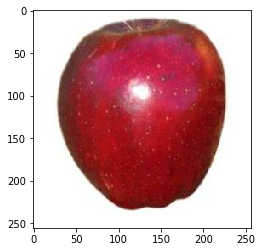

In [6]:
PATH = './datasets/apple2orange/'
inpA = load(os.path.join(PATH, 'trainA/n07740461_10067.jpg'))
print(inpA.shape)
# casting to int for matplotlib to show the image
plt.figure()
plt.imshow(inpA/255.0)

(256, 256, 3)


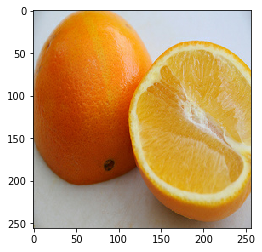

In [7]:
inpB = load(os.path.join(PATH, 'trainB/n07749192_10205.jpg'))
print(inpB.shape)

plt.figure()
plt.imshow(inpB/255)

In [0]:
BATCH_SIZE = 1
base_dir = '/content/datasets/apple2orange/'
BUFFER_SIZE = 32

trainA_dataset = tf.data.Dataset.list_files(PATH+'trainA/*.jpg')
trainA_dataset = trainA_dataset.shuffle(BUFFER_SIZE)
trainA_dataset = trainA_dataset.map(load_image_train)
trainA_dataset = trainA_dataset.batch(BATCH_SIZE, drop_remainder=True)
trainA_dataset = trainA_dataset.prefetch(buffer_size=1)

trainB_dataset = tf.data.Dataset.list_files(PATH+'trainB/*.jpg')
trainB_dataset = trainB_dataset.shuffle(BUFFER_SIZE)
trainB_dataset = trainB_dataset.map(load_image_train)
trainB_dataset = trainB_dataset.batch(BATCH_SIZE, drop_remainder=True)
trainB_dataset = trainB_dataset.prefetch(buffer_size=1)

In [9]:
ingA = next(iter(trainA_dataset))
ingB = next(iter(trainB_dataset))

print(ingA.numpy().max(), ingA.numpy().min())
print(ingB.numpy().max(), ingB.numpy().min())

1.0 -1.0
0.8745098 -1.0


# Model Building

# Generator

Refer to: https://www.tensorflow.org/alpha/tutorials/generative/pix2pix

In [0]:
def downsample(filters, size=3, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))
    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())
    result.add(tf.keras.layers.LeakyReLU())

    return result

test downsample


In [11]:
# 256,256,3 => 1,256,256,3 => 1,128,128,3 => 128, 128, 3
down_model = downsample(3)
down_result = down_model(tf.expand_dims(inpA, 0))
print(down_result.shape)

(1, 128, 128, 3)


In [0]:
def upsample(filters, size=4, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

    result.add(tf.keras.layers.BatchNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

    result.add(tf.keras.layers.ReLU())

    return result

test upsample

In [13]:
up_model = upsample(3)
up_result = up_model(down_result)
print(up_result.shape)

(1, 256, 256, 3)


In [14]:
class ResnetIdentityBlock(tf.keras.Model):
  def __init__(self, kernel_size, filters):
    super(ResnetIdentityBlock, self).__init__(name='')
    filters1, filters2, filters3 = filters

    self.conv2a = tf.keras.layers.Conv2D(filters1, (1, 1))
    self.bn2a = tf.keras.layers.BatchNormalization()

    self.conv2b = tf.keras.layers.Conv2D(filters2, kernel_size, padding='same')
    self.bn2b = tf.keras.layers.BatchNormalization()

    self.conv2c = tf.keras.layers.Conv2D(filters3, (1, 1))
    self.bn2c = tf.keras.layers.BatchNormalization()

  def call(self, input_tensor, training=False):
    x = self.conv2a(input_tensor)
    x = self.bn2a(x, training=training)
    x = tf.nn.relu(x)

    x = self.conv2b(x)
    x = self.bn2b(x, training=training)
    x = tf.nn.relu(x)

    x = self.conv2c(x)
    x = self.bn2c(x, training=training)

    x += input_tensor
    return tf.nn.relu(x)

    
block1 = ResnetIdentityBlock(3, [256, 256, 256])
block2 = ResnetIdentityBlock(3, [256, 256, 256])
block3 = ResnetIdentityBlock(3, [256, 256, 256])

resnet = [block1, block2, block3]
print(block1(tf.zeros([1, 32, 32, 256])).shape)
print([x.name for x in block1.trainable_variables])

(1, 32, 32, 256)
['resnet_identity_block/conv2d_1/kernel:0', 'resnet_identity_block/conv2d_1/bias:0', 'resnet_identity_block/batch_normalization_v2_2/gamma:0', 'resnet_identity_block/batch_normalization_v2_2/beta:0', 'resnet_identity_block/conv2d_2/kernel:0', 'resnet_identity_block/conv2d_2/bias:0', 'resnet_identity_block/batch_normalization_v2_3/gamma:0', 'resnet_identity_block/batch_normalization_v2_3/beta:0', 'resnet_identity_block/conv2d_3/kernel:0', 'resnet_identity_block/conv2d_3/bias:0', 'resnet_identity_block/batch_normalization_v2_4/gamma:0', 'resnet_identity_block/batch_normalization_v2_4/beta:0']


In [0]:
def Generator():
    down_stack = [
        downsample(64, 4, apply_batchnorm=False), # (bs, 128, 128, 64)
        downsample(128, 4), # (bs, 64, 64, 128)
        downsample(256, 4), # (bs, 32, 32, 256)
    ]

    up_stack = [
        upsample(128, 4), # (bs, 64, 64, 256)
        upsample(64, 4), # (bs, 128, 128, 128)
    ]

    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(3, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh') # (bs, 256, 256, 3)

    concat = tf.keras.layers.Concatenate()

    inputs = tf.keras.layers.Input(shape=[256, 256, 3])
    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
        
    for block in resnet:
        x = block(x)

    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])

    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

In [0]:
generator = Generator()

(1, 256, 256, 3) 1.0 0.0


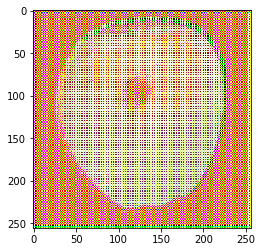

In [17]:
gen_output = generator(tf.expand_dims(inpA, 0), training=False)
gen_output = (gen_output + 1) / 2
plt.imshow(gen_output[0])
print(gen_output.shape,gen_output[0,...].numpy().max(), gen_output[0,...].numpy().min())

In [18]:
generator.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
sequential_2 (Sequential)       (None, 128, 128, 64) 3072        input_1[0][0]                    
__________________________________________________________________________________________________
sequential_3 (Sequential)       (None, 64, 64, 128)  131584      sequential_2[0][0]               
__________________________________________________________________________________________________
sequential_4 (Sequential)       (None, 32, 32, 256)  525312      sequential_3[0][0]               
______________________________________________________________________________________________

# Discriminator

In [0]:
def Discriminator():
    inputs = tf.keras.layers.Input(shape=[None,None,3])
    x = inputs
    g_filter = 64
    
    down_stack = [
        downsample(g_filter),
        downsample(g_filter * 2),
        downsample(g_filter * 4),
        downsample(g_filter * 8),
    ]
    
    for down in down_stack:
        x = down(x)

    last = tf.keras.layers.Conv2D(1, 4, strides=1, padding='same') # (bs, 30, 30, 1)
    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

In [20]:
discriminator = Discriminator()
dis_output = discriminator(tf.expand_dims(inpA, 0), training=False)
print(dis_output.shape)

(1, 16, 16, 1)


## Start Training


In [0]:
def clip(img):
    return (img + 1) / 2

In [0]:
EPOCHS = 200

In [0]:
opti = tf.keras.optimizers.Adam(0.0002, 0.5)

In [0]:
d_A = Discriminator()
d_B = Discriminator()

g_AB = Generator()
g_BA = Generator()

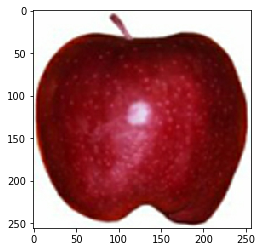

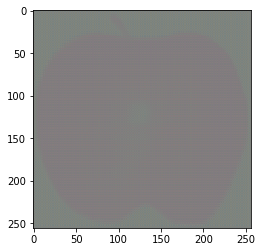

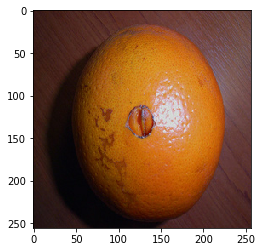

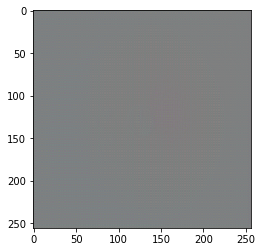

In [25]:
fake_B = g_AB(ingA, training=False)
fake_A = g_BA(ingB, training=False)
logits_A = d_A(ingA, training=False)
logits_B = d_B(ingB, training=False)

plt.figure()
plt.imshow(clip(ingA[0]))
plt.figure()
plt.imshow(clip(fake_B[0]))
plt.figure()
plt.imshow(clip(ingB[0]))
plt.figure()
plt.imshow(clip(fake_A[0]))

In [0]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [0]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

In [0]:
generator_optimizer_AB = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_optimizer_BA = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer_A = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer_B = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [0]:
@tf.function
def train_discriminator(imgs_A, imgs_B):   

    """
    discriminator A
    """
    with tf.GradientTape() as dA_tape:
        logits_real_A = d_A(imgs_A, training=True)
        
        fake_A = g_BA(imgs_B, training=False)
        logits_fake_A = d_A(fake_A, training=True)
        
        dA_loss = discriminator_loss(logits_real_A, logits_fake_A)
        
    gradients_of_dA = dA_tape.gradient(dA_loss, d_A.trainable_variables)
    discriminator_optimizer_A.apply_gradients(zip(gradients_of_dA, d_A.trainable_variables))

    
    """
    discriminator B
    """
    with tf.GradientTape() as dB_tape:
        logits_real_B = d_B(imgs_B, training=True)
        
        fake_B = g_AB(imgs_A, training=False)
        logits_fake_B = d_B(fake_B, training=True)

        dB_loss = discriminator_loss(logits_real_B, logits_fake_B)

    gradients_of_dB = dB_tape.gradient(dB_loss, d_B.trainable_variables)
    discriminator_optimizer_B.apply_gradients(zip(gradients_of_dB, d_B.trainable_variables))

    return [dA_loss, dB_loss]

In [0]:
@tf.function
def train_generator(imgs_A, imgs_B):
    valid = np.ones((BATCH_SIZE, 16, 16, 1)).astype('float32')
    fake = np.zeros((BATCH_SIZE, 16, 16, 1)).astype('float32')
    
    with tf.GradientTape() as g, tf.GradientTape() as gg:     
        fake_B = g_AB(imgs_A, training=True)
        fake_A = g_BA(imgs_B, training=True)
        
        logits_fake_A = d_A(fake_A, training=False)
        logits_fake_B = d_B(fake_B, training=False)
        
        # Translate images back to original domain
        reconstr_A = g_BA(fake_B, training=True)
        reconstr_B = g_AB(fake_A, training=True)
        
        # Identity mapping of images
        img_A_id = g_BA(imgs_A, training=True)
        img_B_id = g_AB(imgs_B, training=True)

        gen_loss_AB = tf.math.reduce_sum([
            0.4 * tf.math.reduce_mean(mean_squared_error(logits_fake_A, valid)),
            0.2 * tf.math.reduce_mean(mean_absolute_error(reconstr_A, imgs_A)),
            0.2 * tf.math.reduce_mean(mean_absolute_error(reconstr_B, imgs_B)),
            0.2 * tf.math.reduce_mean(mean_absolute_error(img_B_id, imgs_B))
        ])
        
        gen_loss_BA = tf.math.reduce_sum([
            0.4 * tf.math.reduce_mean(mean_squared_error(logits_fake_B, valid)),
            0.2 * tf.math.reduce_mean(mean_absolute_error(reconstr_A, imgs_A)),
            0.2 * tf.math.reduce_mean(mean_absolute_error(reconstr_B, imgs_B)),
            0.2 * tf.math.reduce_mean(mean_absolute_error(img_A_id, imgs_A)),
        ])

    gradients_of_generator_AB = g.gradient(gen_loss_AB, g_AB.trainable_variables)
    generator_optimizer_AB.apply_gradients(zip(gradients_of_generator_AB, g_AB.trainable_variables))
    
    gradients_of_generator_BA = gg.gradient(gen_loss_BA, g_BA.trainable_variables)
    generator_optimizer_BA.apply_gradients(zip(gradients_of_generator_BA, g_BA.trainable_variables))
    return [gen_loss_AB, gen_loss_BA]

In [0]:
def train(train_A_dataset, train_B_dataset, epochs):
    for epoch in range(epochs):
        for batch_i, (imgs_A, imgs_B) in enumerate(zip(train_A_dataset, train_B_dataset)):
            start = time.time()
            d_loss = train_discriminator(imgs_A, imgs_B)
            g_loss = train_generator(imgs_A, imgs_B)
            if batch_i % 100 == 0:
                ingA = next(iter(trainA_dataset))
                ingB = next(iter(trainB_dataset))
                print ('Time taken for batch in {} epoch {} is {} sec\n'.format(batch_i, epoch, time.time()-start))
                print("discriminator A: ", d_loss[0].numpy())
                print("discriminator B: ", d_loss[1].numpy())
                print("generator: {}\n".format([i.numpy() for i in g_loss]))
                plt.figure()
                gen_output = g_AB(ingA, training=False)
                plt.imshow(clip(gen_output[0]))
                plt.show()
                plt.figure()
                gen_outputB = g_BA(ingB, training=False)
                plt.imshow(clip(gen_outputB[0]))
                plt.show()   
        print("The epoch now is ", epoch)

Time taken for batch in 0 epoch 0 is 23.777546644210815 sec

discriminator A:  1.6215827
discriminator B:  1.5010338
generator: [0.7706394, 0.8023726]



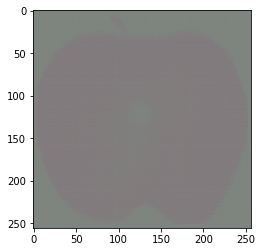

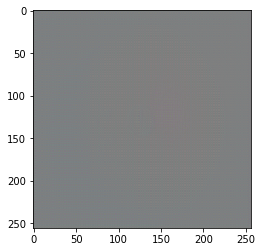

Time taken for batch in 100 epoch 0 is 0.5311722755432129 sec

discriminator A:  0.15198001
discriminator B:  0.27571064
generator: [0.33314073, 0.22287452]



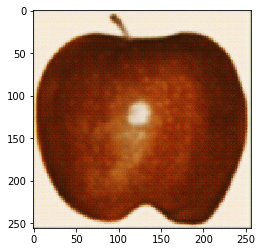

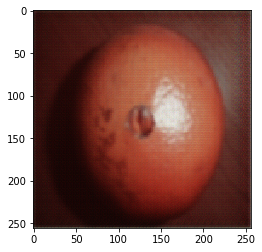

Time taken for batch in 200 epoch 0 is 0.5366106033325195 sec

discriminator A:  0.2690115
discriminator B:  0.3846205
generator: [0.73728496, 0.56059015]



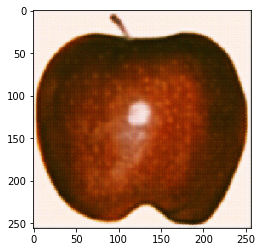

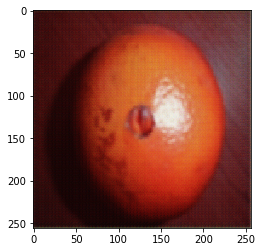

Time taken for batch in 300 epoch 0 is 0.5454070568084717 sec

discriminator A:  0.1761109
discriminator B:  0.19572064
generator: [1.1541643, 0.4741722]



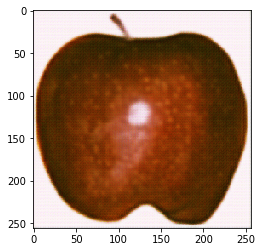

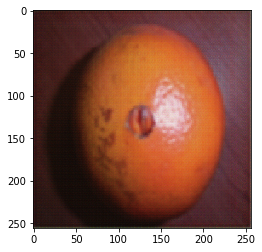

Time taken for batch in 400 epoch 0 is 0.5464060306549072 sec

discriminator A:  0.07323003
discriminator B:  1.2085973
generator: [1.1026654, 3.0668375]



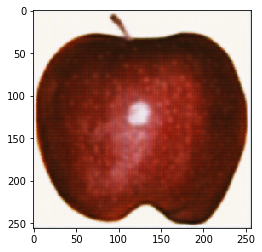

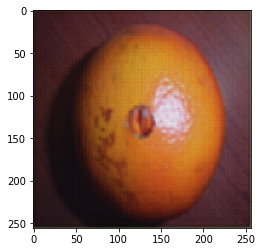

Time taken for batch in 500 epoch 0 is 0.5487048625946045 sec

discriminator A:  0.15048584
discriminator B:  0.35210997
generator: [2.9610827, 0.8188352]



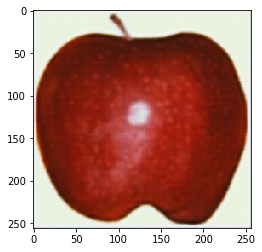

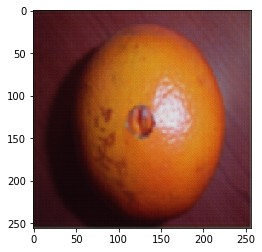

Time taken for batch in 600 epoch 0 is 0.5549740791320801 sec

discriminator A:  0.015862167
discriminator B:  0.023772368
generator: [0.39739433, 0.989344]



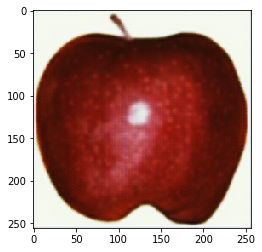

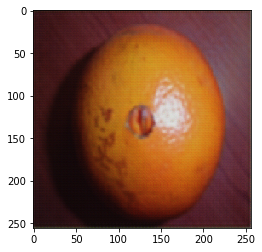

Time taken for batch in 700 epoch 0 is 0.5512752532958984 sec

discriminator A:  0.052517958
discriminator B:  0.06646492
generator: [7.1189165, 4.623054]



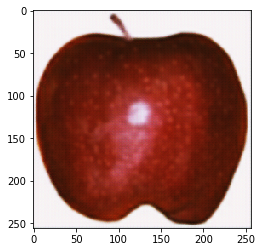

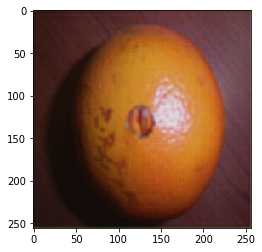

Time taken for batch in 800 epoch 0 is 0.5922081470489502 sec

discriminator A:  0.12365884
discriminator B:  0.029749516
generator: [2.2603512, 1.5179123]



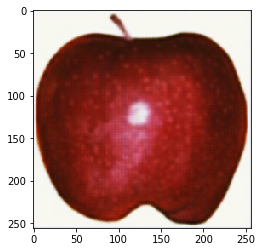

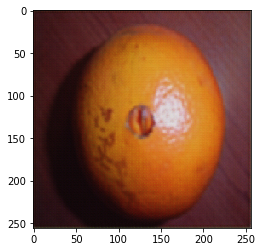

Time taken for batch in 900 epoch 0 is 0.5406675338745117 sec

discriminator A:  0.14912044
discriminator B:  0.13669224
generator: [2.780373, 0.4574578]



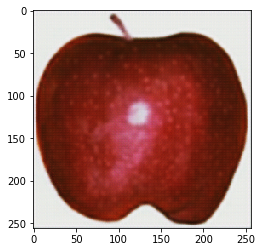

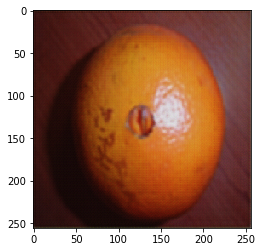

The epoch now is  0
Time taken for batch in 0 epoch 1 is 0.5130319595336914 sec

discriminator A:  0.015679203
discriminator B:  0.009326294
generator: [0.59987813, 2.6793787]



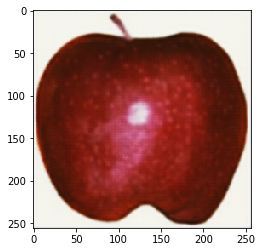

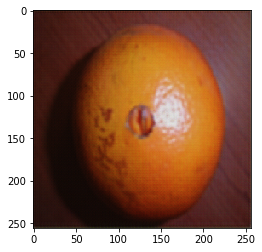

Time taken for batch in 100 epoch 1 is 0.5472292900085449 sec

discriminator A:  0.0034445855
discriminator B:  0.0041098776
generator: [1.3600829, 1.7261598]



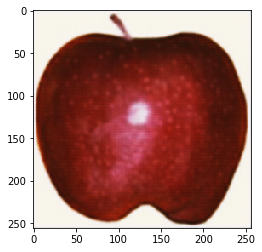

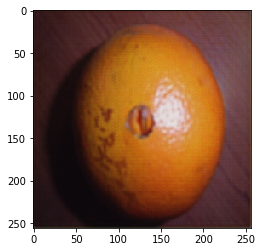

Time taken for batch in 200 epoch 1 is 0.5083215236663818 sec

discriminator A:  0.10270353
discriminator B:  0.42095214
generator: [1.675337, 3.3637161]



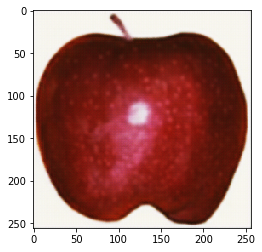

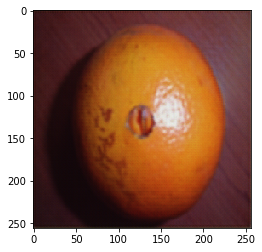

Time taken for batch in 300 epoch 1 is 0.5077724456787109 sec

discriminator A:  0.31667095
discriminator B:  0.47297996
generator: [1.1863085, 0.93028295]



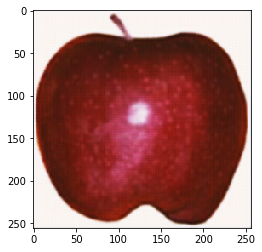

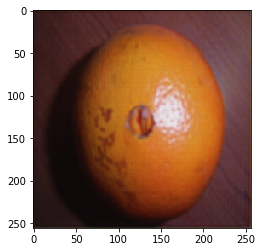

Time taken for batch in 400 epoch 1 is 0.51003098487854 sec

discriminator A:  0.014214635
discriminator B:  0.064011715
generator: [2.6393225, 0.6677163]



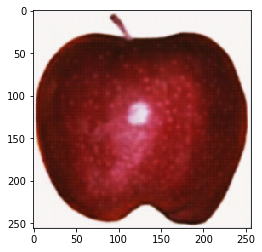

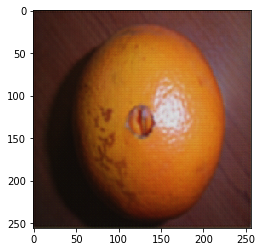

Time taken for batch in 500 epoch 1 is 0.5077881813049316 sec

discriminator A:  0.015158946
discriminator B:  0.096734
generator: [0.80151296, 1.4352438]



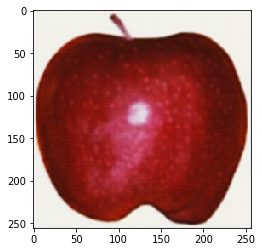

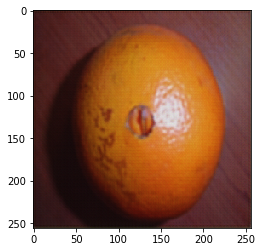

Time taken for batch in 600 epoch 1 is 0.5242471694946289 sec

discriminator A:  0.0026471978
discriminator B:  0.07351845
generator: [1.842159, 0.6540046]



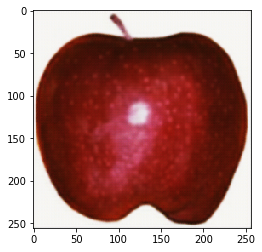

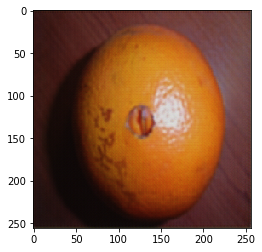

Time taken for batch in 700 epoch 1 is 0.5559444427490234 sec

discriminator A:  0.0030234419
discriminator B:  0.0425287
generator: [0.58175015, 0.40303057]



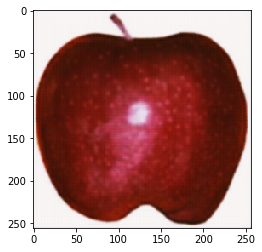

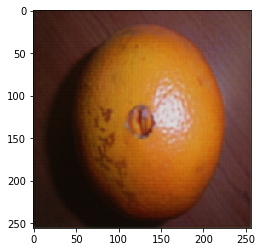

Time taken for batch in 800 epoch 1 is 0.5132784843444824 sec

discriminator A:  0.05488343
discriminator B:  0.033468165
generator: [7.6240363, 1.4736675]



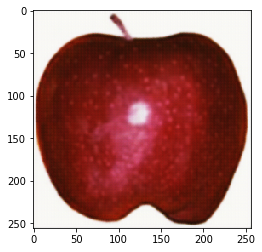

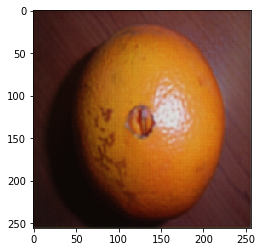

Time taken for batch in 900 epoch 1 is 0.517167329788208 sec

discriminator A:  0.10036508
discriminator B:  0.21191773
generator: [2.962707, 1.3966528]



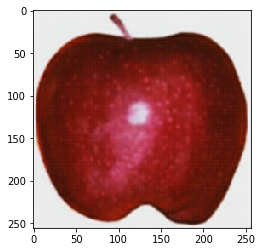

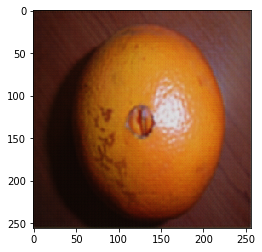

The epoch now is  1
Time taken for batch in 0 epoch 2 is 0.49435949325561523 sec

discriminator A:  0.004395043
discriminator B:  0.0036736485
generator: [0.61579907, 0.5896759]



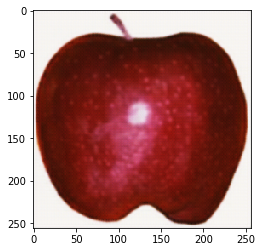

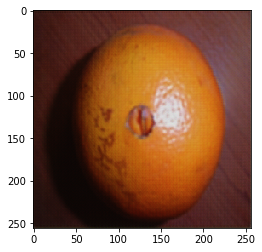

Time taken for batch in 100 epoch 2 is 0.5098834037780762 sec

discriminator A:  0.0042177867
discriminator B:  0.005211328
generator: [1.488649, 1.7332835]



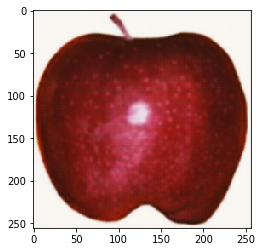

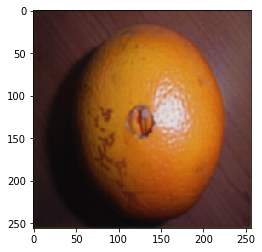

Time taken for batch in 200 epoch 2 is 0.5066018104553223 sec

discriminator A:  0.048639923
discriminator B:  0.016563332
generator: [1.0319959, 0.92554873]



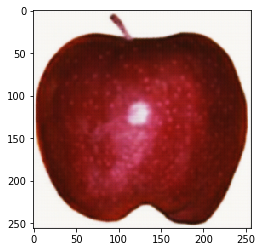

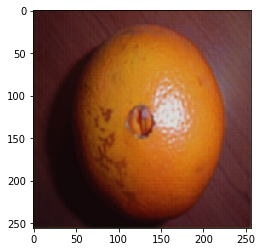

Time taken for batch in 300 epoch 2 is 0.5137903690338135 sec

discriminator A:  0.049080204
discriminator B:  0.16600206
generator: [3.469255, 0.8609983]



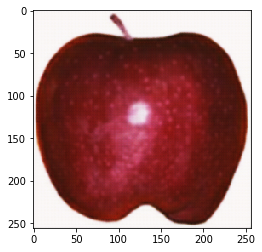

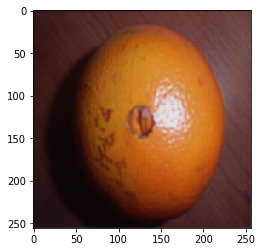

Time taken for batch in 400 epoch 2 is 0.521390438079834 sec

discriminator A:  0.025017047
discriminator B:  0.04656917
generator: [1.9318168, 0.550391]



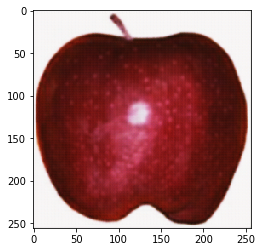

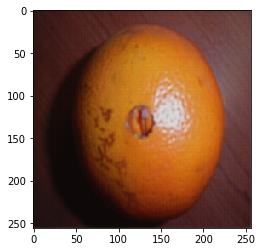

Time taken for batch in 500 epoch 2 is 0.5282809734344482 sec

discriminator A:  0.026052188
discriminator B:  0.05448181
generator: [1.1576607, 1.9450545]



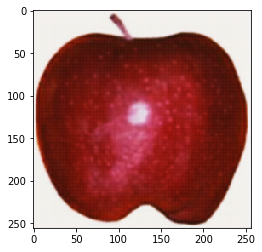

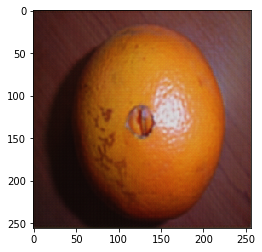

Time taken for batch in 600 epoch 2 is 0.525493860244751 sec

discriminator A:  0.0032444065
discriminator B:  0.011284902
generator: [1.2567395, 1.1962872]



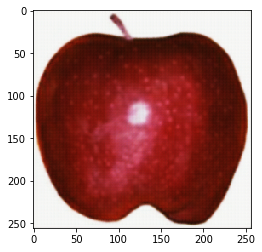

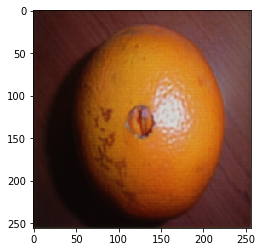

Time taken for batch in 700 epoch 2 is 0.5219686031341553 sec

discriminator A:  0.06912104
discriminator B:  0.012830212
generator: [4.7458415, 1.2076257]



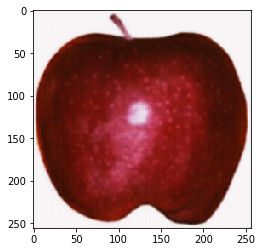

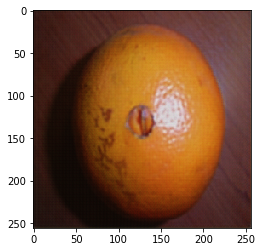

Time taken for batch in 800 epoch 2 is 0.5667760372161865 sec

discriminator A:  0.011800699
discriminator B:  0.017273284
generator: [3.2265425, 1.7536182]



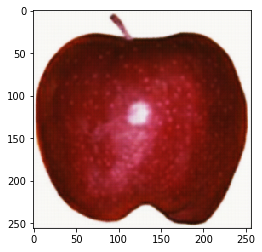

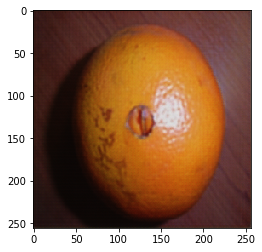

Time taken for batch in 900 epoch 2 is 0.5145175457000732 sec

discriminator A:  0.07646937
discriminator B:  0.068190195
generator: [1.862688, 0.7293442]



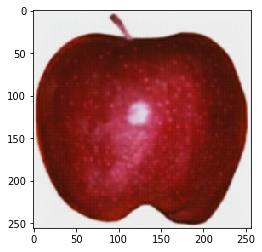

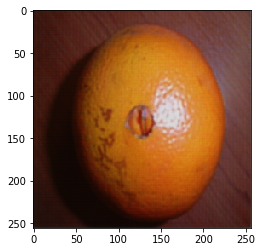

The epoch now is  2
Time taken for batch in 0 epoch 3 is 0.5482876300811768 sec

discriminator A:  0.0021124207
discriminator B:  0.0028300076
generator: [1.295192, 1.0638777]



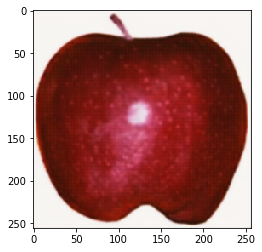

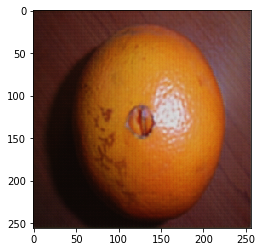

Time taken for batch in 100 epoch 3 is 0.5193271636962891 sec

discriminator A:  0.0049684485
discriminator B:  0.0032350286
generator: [0.6594499, 1.322609]



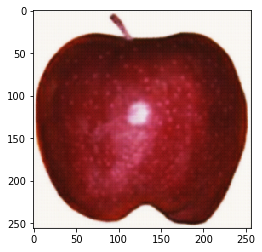

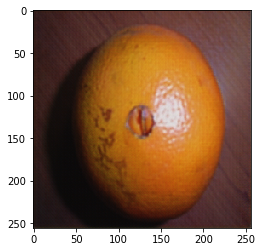

Time taken for batch in 200 epoch 3 is 0.5130565166473389 sec

discriminator A:  0.046951327
discriminator B:  0.079132915
generator: [2.3694131, 1.3390434]



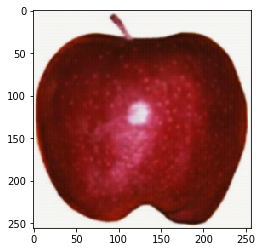

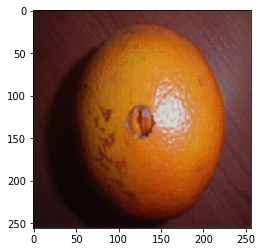

Time taken for batch in 300 epoch 3 is 0.518784761428833 sec

discriminator A:  0.118302375
discriminator B:  0.78019583
generator: [9.108647, 0.4823887]



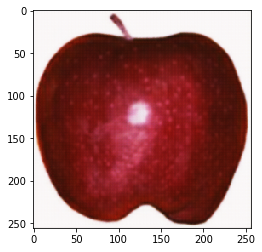

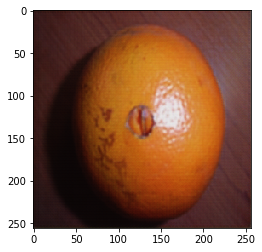

Time taken for batch in 400 epoch 3 is 0.5211460590362549 sec

discriminator A:  0.023135908
discriminator B:  0.15453383
generator: [1.940376, 0.50801265]



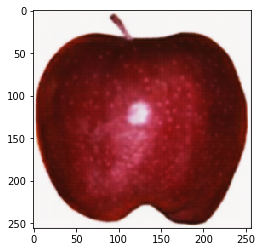

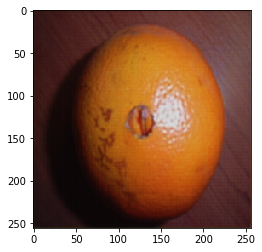

Time taken for batch in 500 epoch 3 is 0.5176723003387451 sec

discriminator A:  1.3090435
discriminator B:  0.19717298
generator: [3.0574012, 1.6256967]



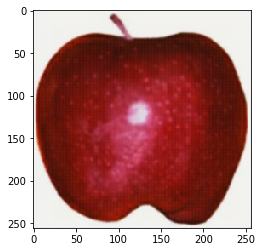

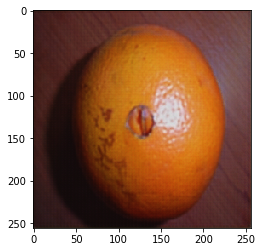

Time taken for batch in 600 epoch 3 is 0.5384411811828613 sec

discriminator A:  0.0788173
discriminator B:  0.02426154
generator: [1.5694431, 5.0112557]



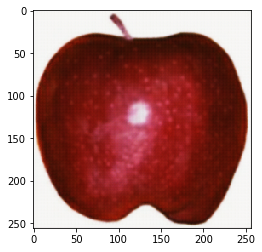

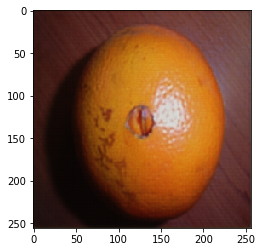

Time taken for batch in 700 epoch 3 is 0.5226452350616455 sec

discriminator A:  0.008622908
discriminator B:  0.016142251
generator: [1.3586346, 1.5971664]



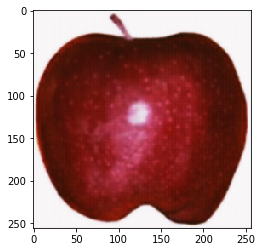

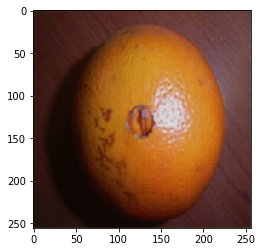

Time taken for batch in 800 epoch 3 is 0.5255239009857178 sec

discriminator A:  0.015208149
discriminator B:  0.027965259
generator: [1.1638924, 1.0504128]



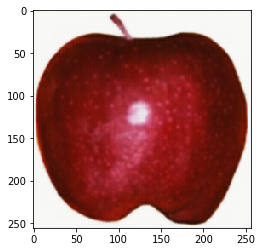

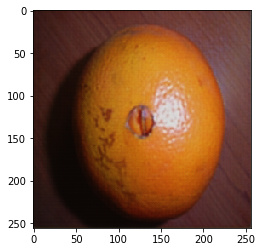

Time taken for batch in 900 epoch 3 is 0.5664691925048828 sec

discriminator A:  0.18241066
discriminator B:  0.4756367
generator: [1.2786034, 3.431654]



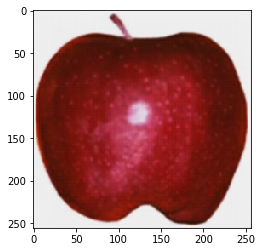

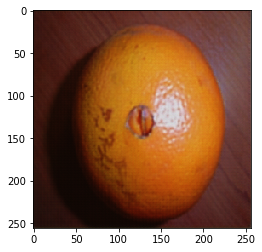

The epoch now is  3
Time taken for batch in 0 epoch 4 is 0.4991607666015625 sec

discriminator A:  0.0009453717
discriminator B:  0.002307199
generator: [2.0522492, 2.4688945]



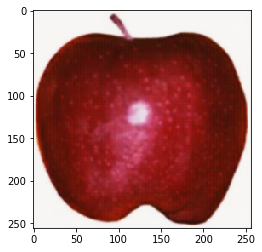

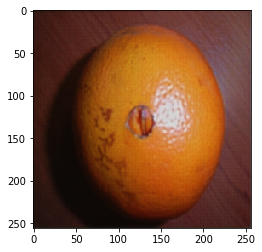

Time taken for batch in 100 epoch 4 is 0.5163648128509521 sec

discriminator A:  0.004504909
discriminator B:  0.0020500051
generator: [0.6501539, 0.7089001]



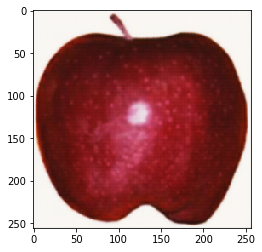

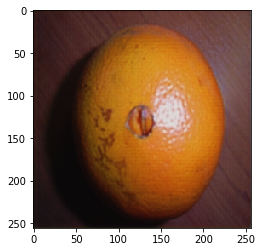

Time taken for batch in 200 epoch 4 is 0.5173923969268799 sec

discriminator A:  0.083235666
discriminator B:  0.0073011494
generator: [0.26602548, 0.77334315]



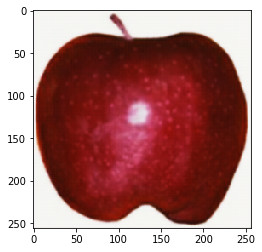

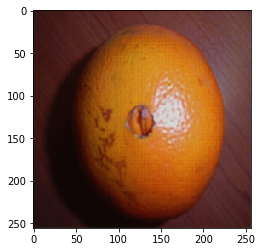

Time taken for batch in 300 epoch 4 is 0.5460529327392578 sec

discriminator A:  0.08203657
discriminator B:  0.13741617
generator: [0.49056453, 1.408788]



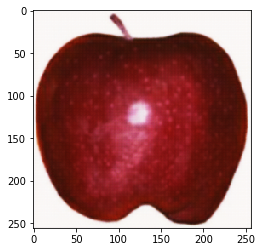

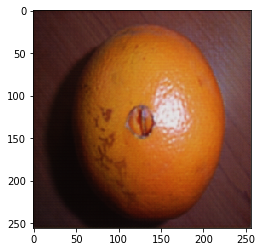

Time taken for batch in 400 epoch 4 is 0.519141435623169 sec

discriminator A:  0.005674
discriminator B:  0.0140270125
generator: [1.9205824, 1.2818488]



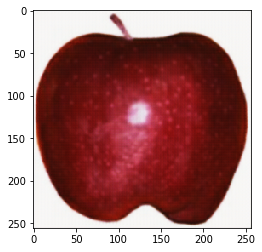

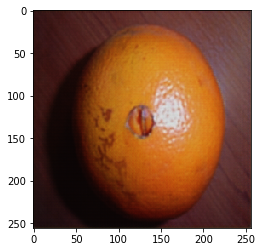

Time taken for batch in 500 epoch 4 is 0.5813453197479248 sec

discriminator A:  0.14114946
discriminator B:  0.028363615
generator: [0.2601971, 1.8578218]



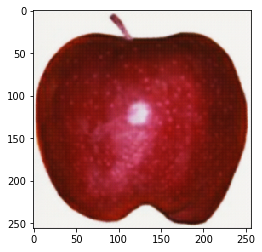

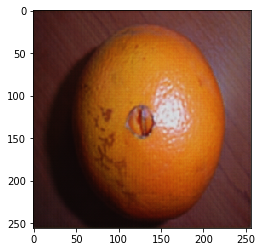

Time taken for batch in 600 epoch 4 is 0.5760190486907959 sec

discriminator A:  0.0013978409
discriminator B:  0.14297074
generator: [1.5769044, 1.1617801]



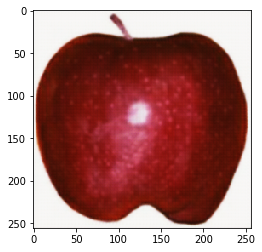

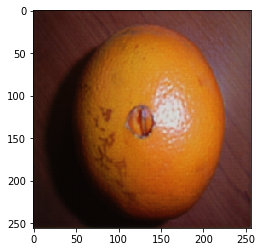

Time taken for batch in 700 epoch 4 is 0.5708267688751221 sec

discriminator A:  0.0021838793
discriminator B:  0.032998025
generator: [0.9757241, 4.1183705]



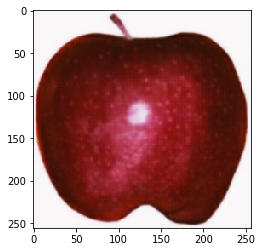

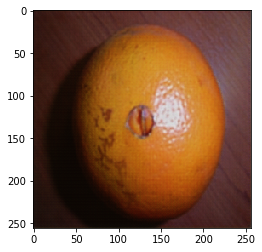

Time taken for batch in 800 epoch 4 is 0.565392255783081 sec

discriminator A:  0.009605136
discriminator B:  0.0186875
generator: [0.36393213, 1.9728798]



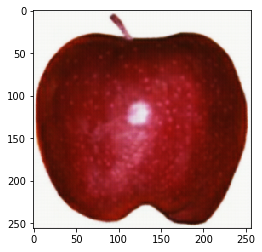

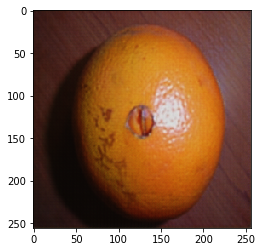

Time taken for batch in 900 epoch 4 is 0.5917782783508301 sec

discriminator A:  0.12057733
discriminator B:  0.16555247
generator: [0.59211767, 2.1557567]



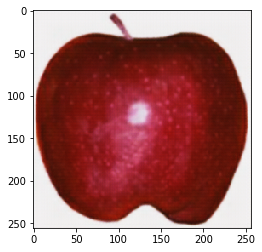

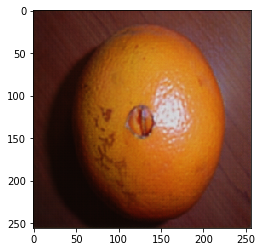

The epoch now is  4
Time taken for batch in 0 epoch 5 is 0.504335880279541 sec

discriminator A:  0.0015973569
discriminator B:  0.005749047
generator: [1.8941858, 0.6595013]



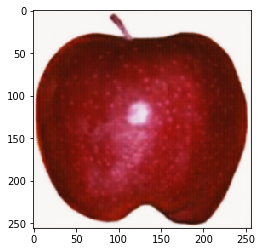

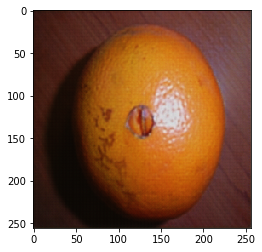

Time taken for batch in 100 epoch 5 is 0.5663602352142334 sec

discriminator A:  0.0028822408
discriminator B:  0.0022870135
generator: [8.305126, 0.828195]



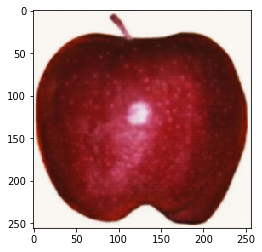

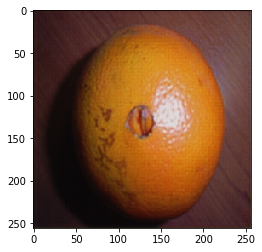

Time taken for batch in 200 epoch 5 is 0.51654052734375 sec

discriminator A:  0.07981203
discriminator B:  0.12627754
generator: [0.83456653, 1.2241789]



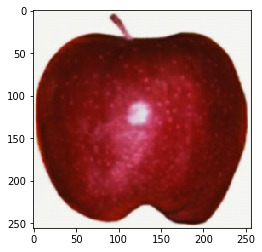

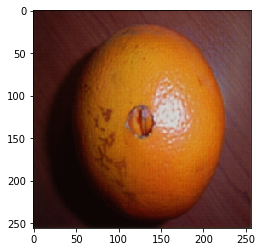

Time taken for batch in 300 epoch 5 is 0.5270535945892334 sec

discriminator A:  0.77367777
discriminator B:  0.54166603
generator: [1.8194485, 2.7534275]



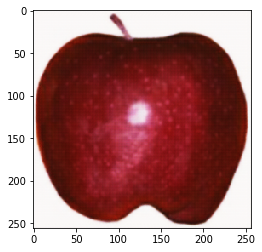

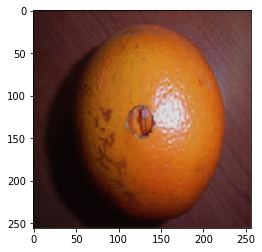

Time taken for batch in 400 epoch 5 is 0.5220849514007568 sec

discriminator A:  0.02380504
discriminator B:  0.0052497084
generator: [2.1582794, 1.8970758]



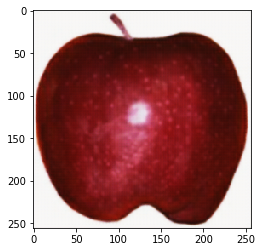

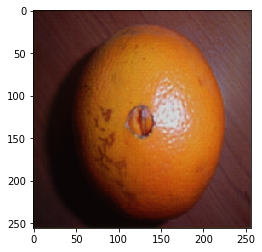

Time taken for batch in 500 epoch 5 is 0.5175251960754395 sec

discriminator A:  0.2705848
discriminator B:  0.023584735
generator: [0.8768129, 1.046358]



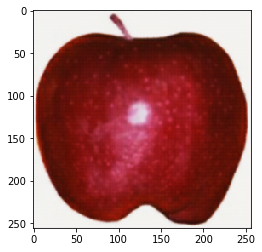

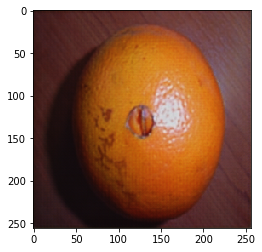

Time taken for batch in 600 epoch 5 is 0.5611469745635986 sec

discriminator A:  0.0038703238
discriminator B:  0.0060540885
generator: [0.70767844, 0.78947365]



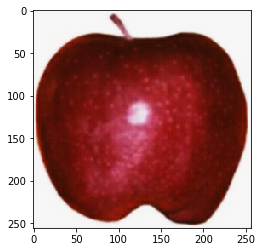

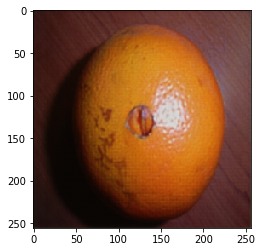

Time taken for batch in 700 epoch 5 is 0.5330159664154053 sec

discriminator A:  0.0036102806
discriminator B:  0.009675368
generator: [1.502346, 1.0700381]



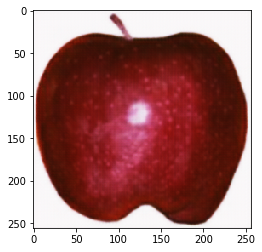

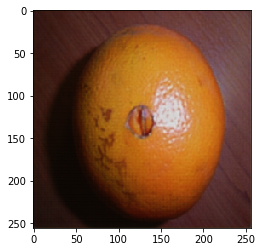

Time taken for batch in 800 epoch 5 is 0.5328450202941895 sec

discriminator A:  0.009614379
discriminator B:  0.011569709
generator: [0.29821807, 1.9575714]



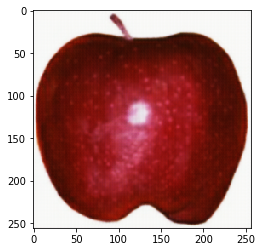

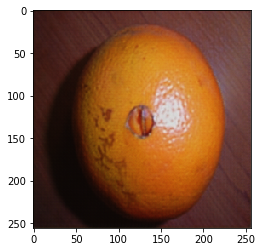

Time taken for batch in 900 epoch 5 is 0.546588659286499 sec

discriminator A:  0.075223856
discriminator B:  0.13070539
generator: [2.8959756, 0.60479355]



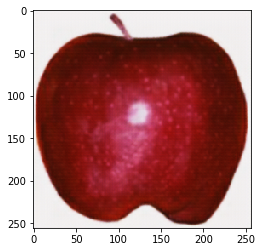

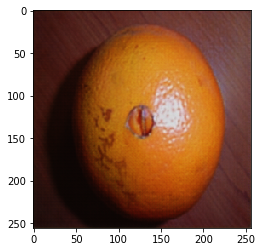

The epoch now is  5
Time taken for batch in 0 epoch 6 is 0.5028631687164307 sec

discriminator A:  0.0033584586
discriminator B:  0.10274521
generator: [0.8118341, 9.000354]



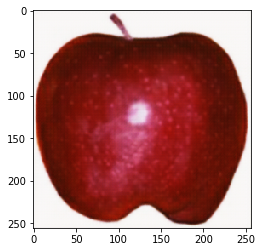

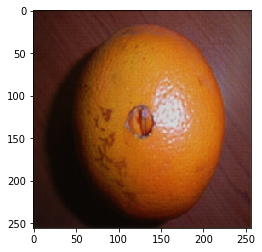

Time taken for batch in 100 epoch 6 is 0.5135979652404785 sec

discriminator A:  0.001592105
discriminator B:  0.0025692051
generator: [3.7111826, 0.55093706]



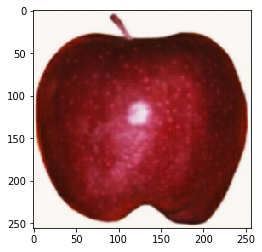

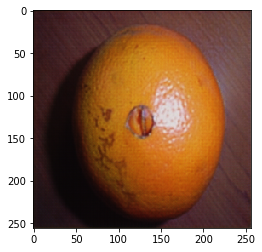

Time taken for batch in 200 epoch 6 is 0.5267765522003174 sec

discriminator A:  0.04033183
discriminator B:  0.5928252
generator: [1.4505522, 0.70502746]



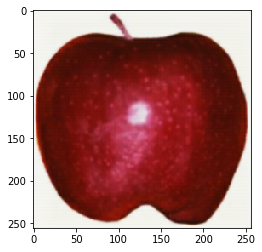

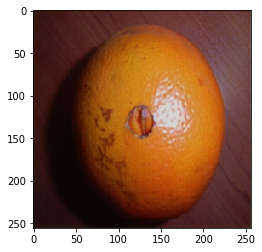

Time taken for batch in 300 epoch 6 is 0.5239872932434082 sec

discriminator A:  0.06133756
discriminator B:  0.30844042
generator: [0.5036105, 1.2382963]



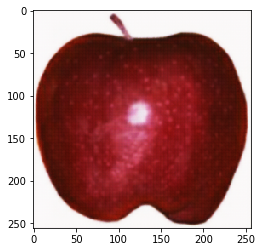

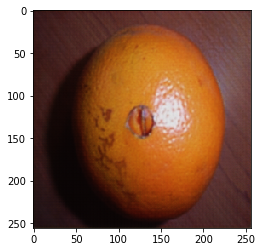

Time taken for batch in 400 epoch 6 is 0.5209901332855225 sec

discriminator A:  1.6147947
discriminator B:  0.0020009424
generator: [0.9816495, 2.5421448]



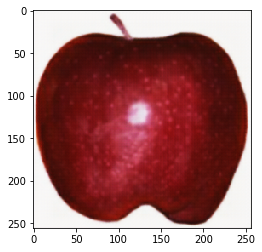

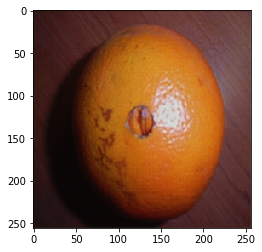

Time taken for batch in 500 epoch 6 is 0.5245540142059326 sec

discriminator A:  0.12613389
discriminator B:  0.070683114
generator: [2.692527, 1.2887024]



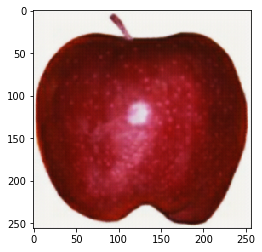

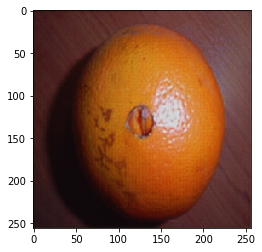

Time taken for batch in 600 epoch 6 is 0.5256226062774658 sec

discriminator A:  0.008308873
discriminator B:  0.16351782
generator: [0.47133476, 0.45086232]



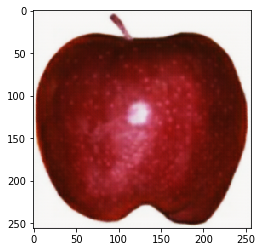

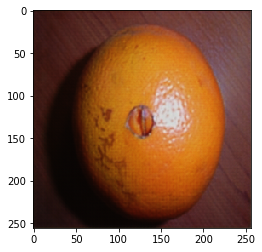

Time taken for batch in 700 epoch 6 is 0.5699410438537598 sec

discriminator A:  0.0044429484
discriminator B:  0.018874552
generator: [0.80684525, 0.67631674]



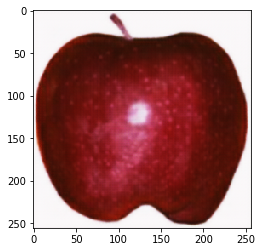

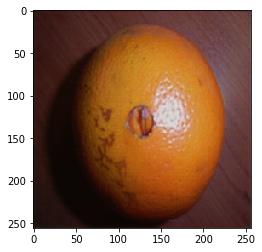

Time taken for batch in 800 epoch 6 is 0.5344994068145752 sec

discriminator A:  0.009601729
discriminator B:  0.022949006
generator: [0.8029764, 1.2606878]



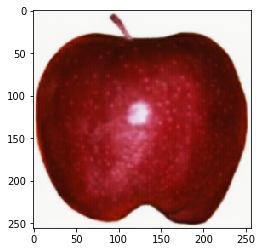

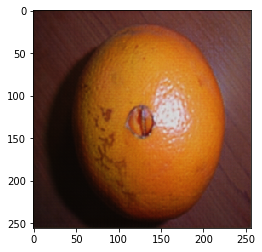

Time taken for batch in 900 epoch 6 is 0.516035795211792 sec

discriminator A:  0.16703306
discriminator B:  0.11204451
generator: [0.92822987, 1.7543043]



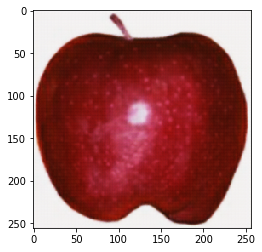

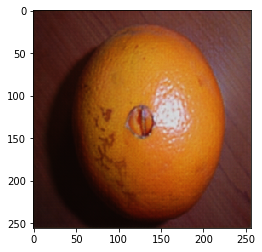

The epoch now is  6
Time taken for batch in 0 epoch 7 is 0.5012338161468506 sec

discriminator A:  0.0023795308
discriminator B:  0.0026119377
generator: [1.3390481, 1.6219627]



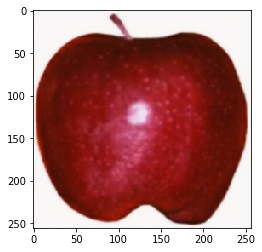

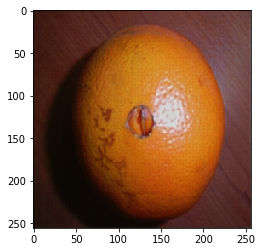

Time taken for batch in 100 epoch 7 is 0.5214648246765137 sec

discriminator A:  0.00051210774
discriminator B:  0.0021036603
generator: [1.5663122, 1.4782908]



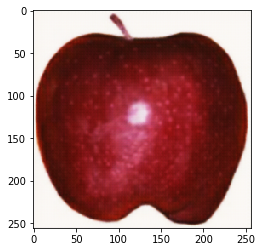

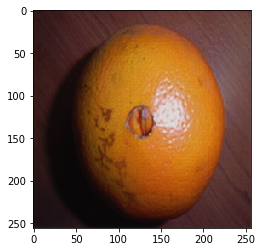

Time taken for batch in 200 epoch 7 is 0.5221633911132812 sec

discriminator A:  0.03993618
discriminator B:  0.30499053
generator: [3.7346356, 4.699448]



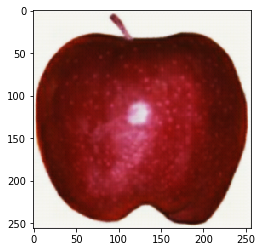

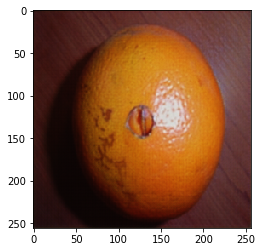

Time taken for batch in 300 epoch 7 is 0.5908496379852295 sec

discriminator A:  0.021284975
discriminator B:  0.33395594
generator: [1.1151766, 0.51852286]



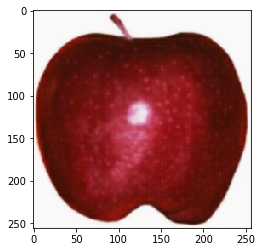

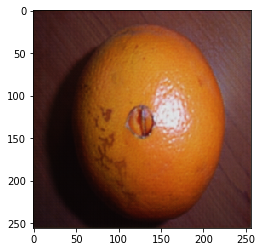

Time taken for batch in 400 epoch 7 is 0.519341230392456 sec

discriminator A:  0.0029166278
discriminator B:  0.010379209
generator: [2.0999796, 1.6634096]



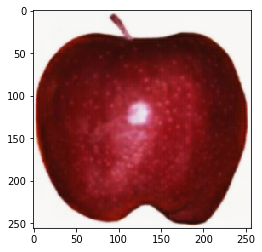

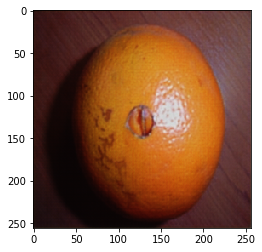

Time taken for batch in 500 epoch 7 is 0.5191409587860107 sec

discriminator A:  0.008132699
discriminator B:  0.039516054
generator: [0.9645162, 1.0507013]



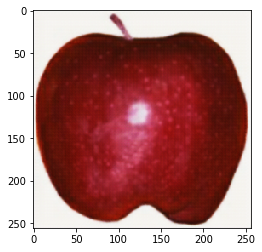

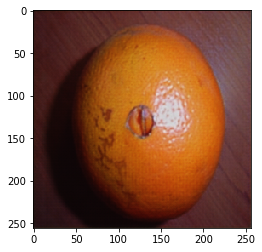

Time taken for batch in 600 epoch 7 is 0.5212159156799316 sec

discriminator A:  0.0013731545
discriminator B:  0.056251813
generator: [1.7618237, 1.1326947]



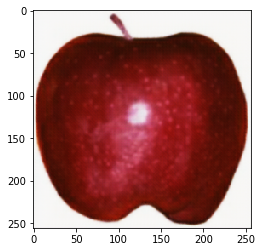

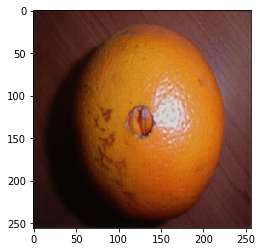

Time taken for batch in 700 epoch 7 is 0.5221447944641113 sec

discriminator A:  0.0025598968
discriminator B:  0.006314728
generator: [1.0177608, 0.8471389]



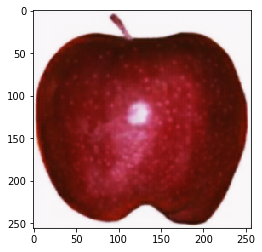

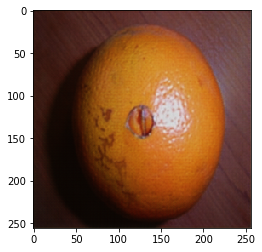

Time taken for batch in 800 epoch 7 is 0.5179791450500488 sec

discriminator A:  0.008247032
discriminator B:  0.024623677
generator: [0.39631534, 1.3528023]



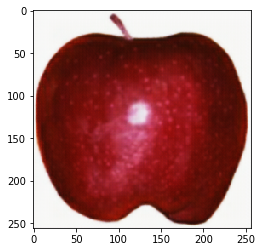

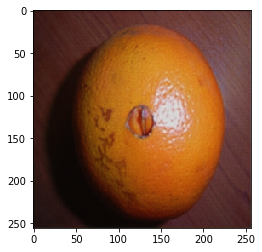

Time taken for batch in 900 epoch 7 is 0.5241711139678955 sec

discriminator A:  0.050947372
discriminator B:  0.17677599
generator: [1.9376771, 0.75566393]



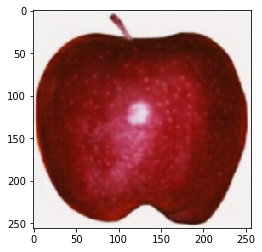

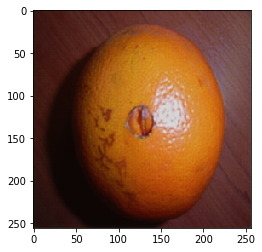

The epoch now is  7
Time taken for batch in 0 epoch 8 is 0.5629334449768066 sec

discriminator A:  0.0011788746
discriminator B:  0.0015330738
generator: [0.9520013, 4.9726467]



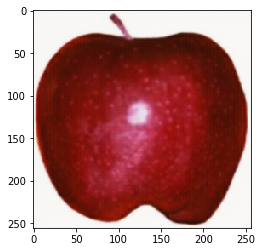

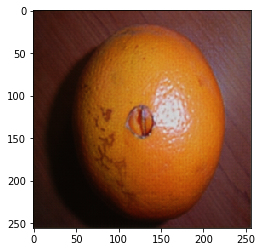

Time taken for batch in 100 epoch 8 is 0.5481431484222412 sec

discriminator A:  0.00054595637
discriminator B:  0.002496926
generator: [3.285824, 2.1857784]



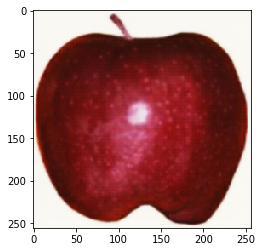

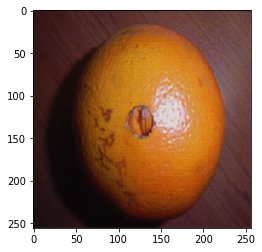

Time taken for batch in 200 epoch 8 is 0.5517489910125732 sec

discriminator A:  0.28634194
discriminator B:  0.0052577634
generator: [2.9295928, 0.8596238]



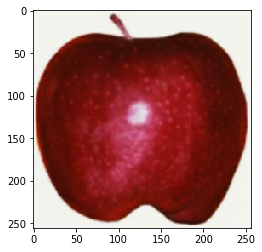

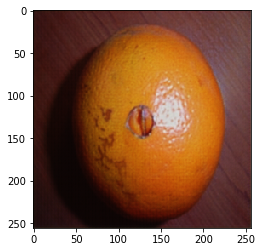

Time taken for batch in 300 epoch 8 is 0.5256361961364746 sec

discriminator A:  0.51366127
discriminator B:  0.20850809
generator: [1.252899, 0.5668552]



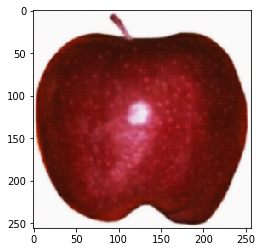

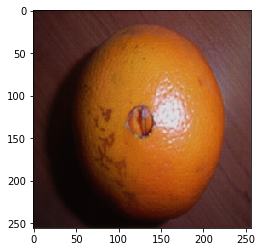

Time taken for batch in 400 epoch 8 is 0.563530683517456 sec

discriminator A:  0.04323434
discriminator B:  3.7667317
generator: [1.1643553, 1.7461616]



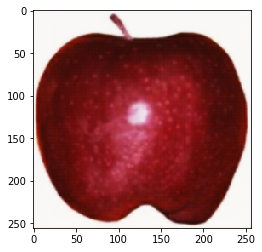

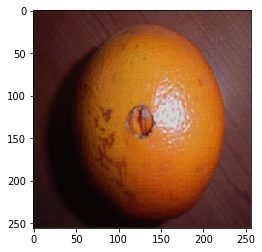

Time taken for batch in 500 epoch 8 is 0.5399343967437744 sec

discriminator A:  0.38097203
discriminator B:  0.4215028
generator: [0.53321916, 3.1071334]



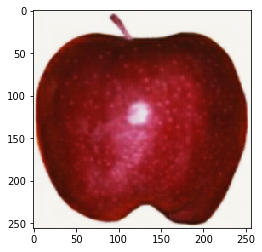

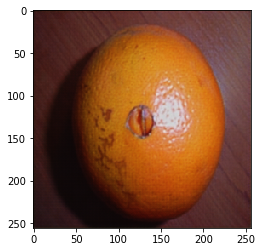

Time taken for batch in 600 epoch 8 is 0.5356168746948242 sec

discriminator A:  0.0015239636
discriminator B:  0.34736657
generator: [1.3323004, 1.7301587]



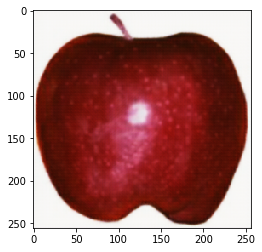

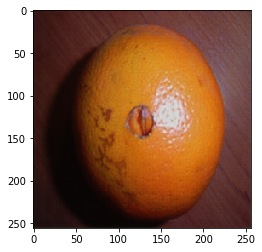

Time taken for batch in 700 epoch 8 is 0.5352306365966797 sec

discriminator A:  0.0021926186
discriminator B:  0.004935658
generator: [1.2387009, 1.1274134]



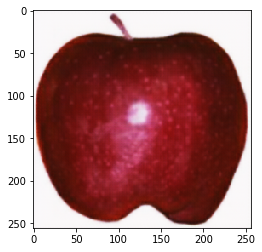

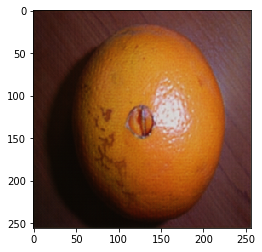

Time taken for batch in 800 epoch 8 is 0.5354363918304443 sec

discriminator A:  0.0044914656
discriminator B:  0.0116578145
generator: [0.3943584, 2.2237437]



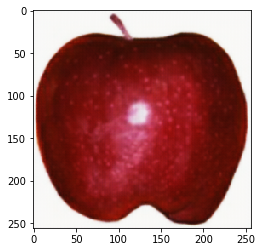

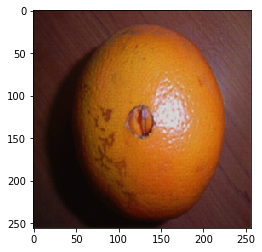

Time taken for batch in 900 epoch 8 is 0.5407044887542725 sec

discriminator A:  0.10943429
discriminator B:  0.7085337
generator: [2.6037052, 0.8025198]



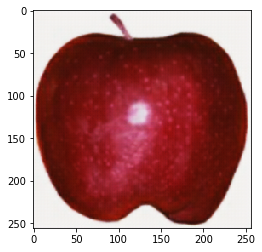

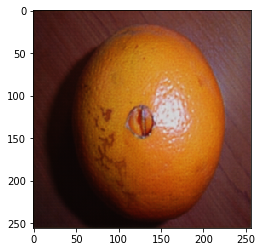

The epoch now is  8
Time taken for batch in 0 epoch 9 is 0.5550143718719482 sec

discriminator A:  0.0017284366
discriminator B:  0.004302844
generator: [1.6157792, 2.3431525]



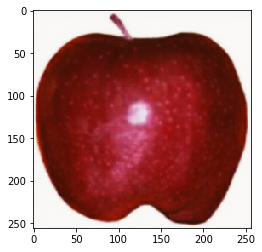

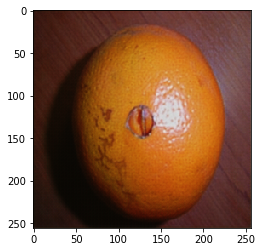

Time taken for batch in 100 epoch 9 is 0.5254819393157959 sec

discriminator A:  0.00020758454
discriminator B:  0.002428512
generator: [3.7278504, 1.0994346]



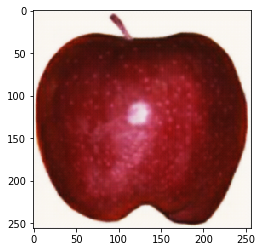

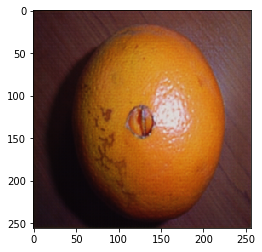

Time taken for batch in 200 epoch 9 is 0.5372614860534668 sec

discriminator A:  0.016077567
discriminator B:  0.0057524024
generator: [3.5722723, 1.1617342]



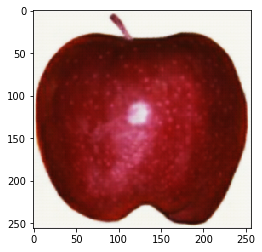

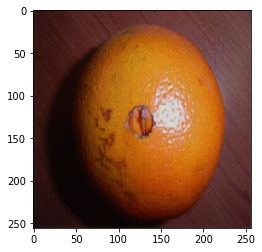

Time taken for batch in 300 epoch 9 is 0.529752254486084 sec

discriminator A:  0.021514162
discriminator B:  0.20454718
generator: [1.2108725, 3.1024318]



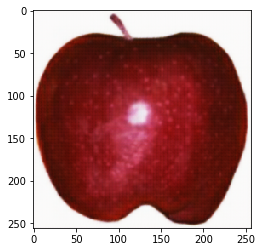

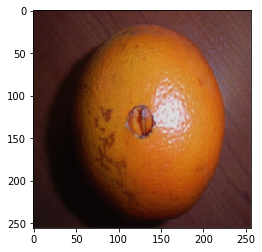

Time taken for batch in 400 epoch 9 is 0.5385382175445557 sec

discriminator A:  0.65087897
discriminator B:  0.011444458
generator: [5.7000914, 2.1075494]



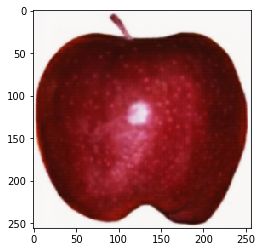

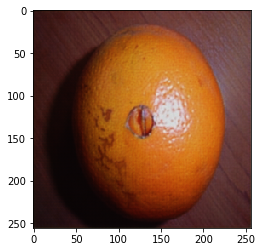

Time taken for batch in 500 epoch 9 is 0.564356803894043 sec

discriminator A:  0.037963614
discriminator B:  0.024018615
generator: [1.3229991, 1.3539581]



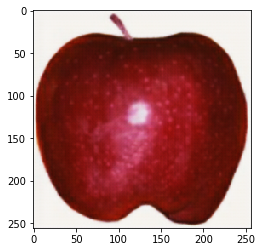

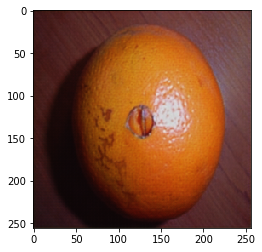

Time taken for batch in 600 epoch 9 is 0.5316107273101807 sec

discriminator A:  0.0017071378
discriminator B:  0.012536768
generator: [1.0582898, 1.8899028]



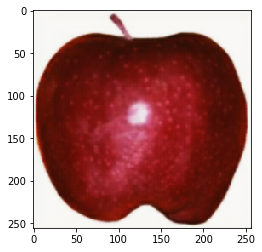

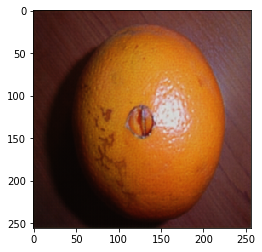

Time taken for batch in 700 epoch 9 is 0.5269129276275635 sec

discriminator A:  0.022511197
discriminator B:  0.015906865
generator: [1.8690985, 6.2261047]



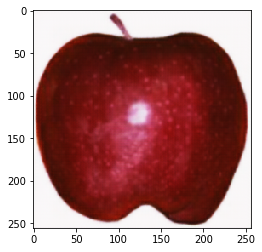

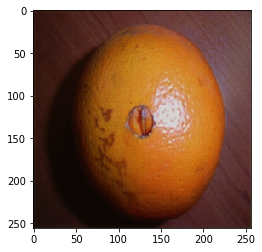

Time taken for batch in 800 epoch 9 is 0.5306479930877686 sec

discriminator A:  0.0076880828
discriminator B:  0.09782515
generator: [1.3417138, 1.9762938]



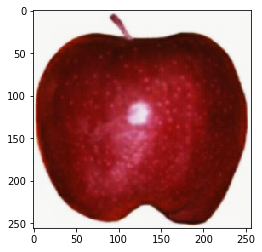

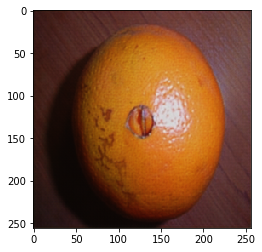

Time taken for batch in 900 epoch 9 is 0.5366919040679932 sec

discriminator A:  0.1641194
discriminator B:  0.15891379
generator: [2.394495, 5.8136926]



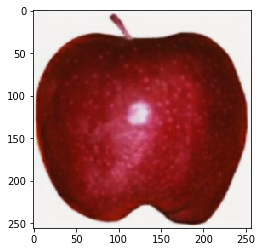

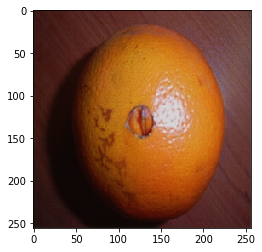

The epoch now is  9
Time taken for batch in 0 epoch 10 is 0.5202596187591553 sec

discriminator A:  0.005395878
discriminator B:  0.0024769325
generator: [1.6615578, 3.7797453]



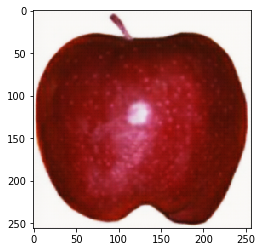

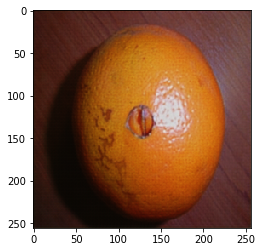

Time taken for batch in 100 epoch 10 is 0.5868330001831055 sec

discriminator A:  0.0015712964
discriminator B:  0.0014755547
generator: [0.6410018, 5.0591125]



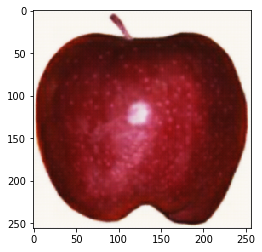

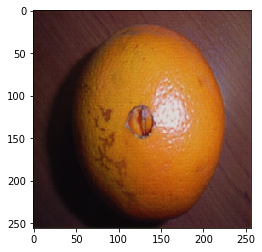

Time taken for batch in 200 epoch 10 is 0.5234823226928711 sec

discriminator A:  0.026868042
discriminator B:  0.0044345083
generator: [1.5199317, 0.8308055]



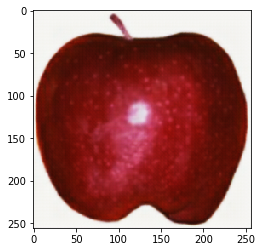

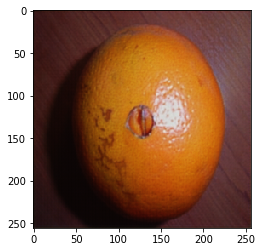

Time taken for batch in 300 epoch 10 is 0.5285069942474365 sec

discriminator A:  0.018750235
discriminator B:  0.049900293
generator: [0.77965915, 2.7972624]



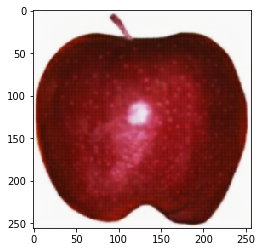

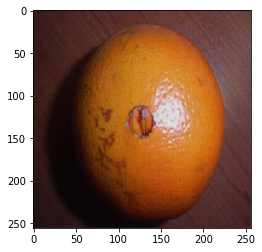

Time taken for batch in 400 epoch 10 is 0.5258142948150635 sec

discriminator A:  0.010769704
discriminator B:  0.0077380696
generator: [5.3570857, 2.2631586]



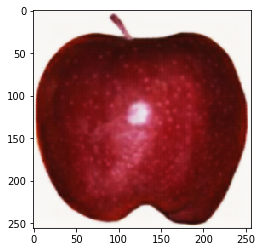

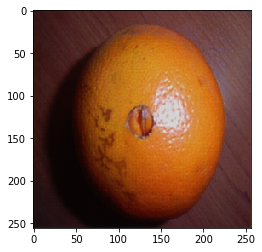

Time taken for batch in 500 epoch 10 is 0.531726598739624 sec

discriminator A:  1.2825134
discriminator B:  0.014169969
generator: [25.029957, 1.7311076]



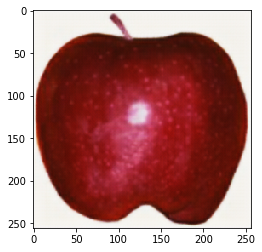

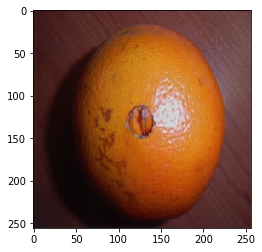

Time taken for batch in 600 epoch 10 is 0.5338916778564453 sec

discriminator A:  0.11856733
discriminator B:  0.009137275
generator: [3.1378489, 1.2128247]



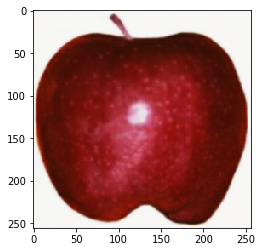

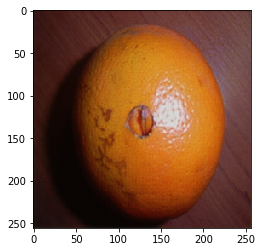

Time taken for batch in 700 epoch 10 is 0.5442028045654297 sec

discriminator A:  0.0017728584
discriminator B:  0.020864056
generator: [1.1520131, 0.41198578]



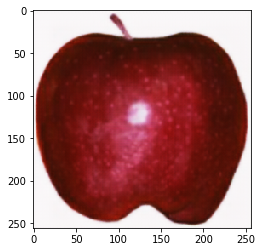

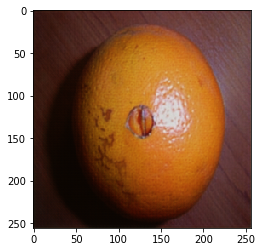

Time taken for batch in 800 epoch 10 is 0.5346393585205078 sec

discriminator A:  0.007222115
discriminator B:  0.008070107
generator: [1.0164449, 2.4611344]



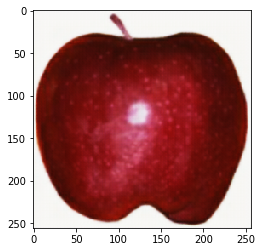

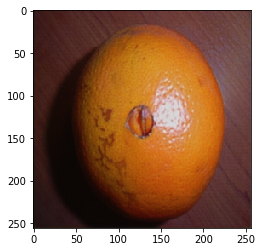

Time taken for batch in 900 epoch 10 is 0.53420090675354 sec

discriminator A:  0.035450555
discriminator B:  0.17428964
generator: [1.4141879, 1.1051947]



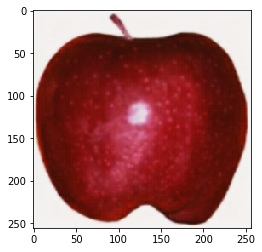

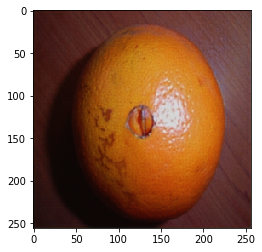

The epoch now is  10
Time taken for batch in 0 epoch 11 is 0.5173890590667725 sec

discriminator A:  0.0013431988
discriminator B:  0.002850226
generator: [0.9132396, 2.3882074]



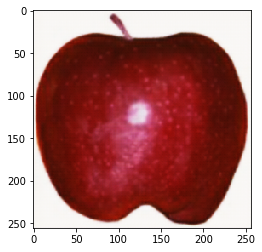

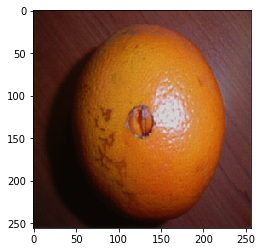

Time taken for batch in 100 epoch 11 is 0.5268430709838867 sec

discriminator A:  0.0003201256
discriminator B:  0.0016468848
generator: [1.0417941, 2.4025822]



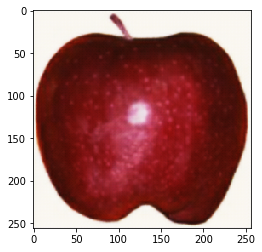

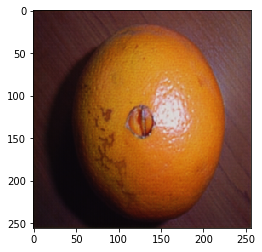

Time taken for batch in 200 epoch 11 is 0.5609755516052246 sec

discriminator A:  0.0037039684
discriminator B:  0.0042214254
generator: [1.2092134, 0.6313265]



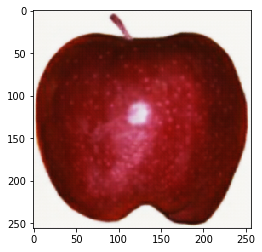

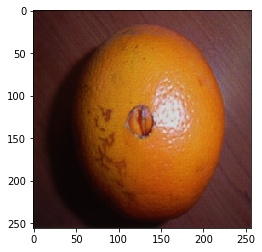

Time taken for batch in 300 epoch 11 is 0.5765995979309082 sec

discriminator A:  0.05025838
discriminator B:  0.10216391
generator: [3.1057944, 3.2668915]



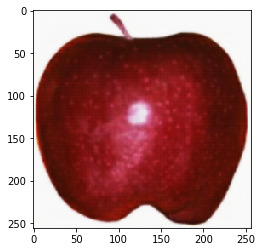

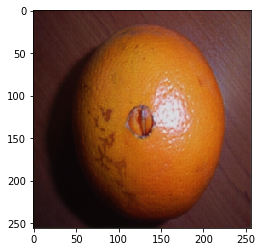

In [0]:
train(trainA_dataset, trainB_dataset, EPOCHS)

In [0]:
fake_B = g_AB(ingA, training=False)
fake_A = g_BA(ingB, training=False)
logits_A = d_A(ingA, training=False)
logits_B = d_B(ingB, training=False)


plt.figure()
plt.imshow(clip(ingA[0]))
plt.figure()
plt.imshow(clip(fake_B[0]))
plt.figure()
plt.imshow(clip(ingB[0]))
plt.figure()
plt.imshow(clip(fake_A[0]))

In [0]:
fake_B = g_AB(img_A, training=False)
fake_A = g_BA(img_B, training=False)

plt.figure()
plt.imshow(img_A[0])
plt.figure()
plt.imshow(fake_B[0])
plt.figure()
plt.imshow(img_B[0])
plt.figure()
plt.imshow(fake_A[0])